<a href="https://colab.research.google.com/github/danielecampli-unitrento/kdpe/blob/main/openreview/openreview_iclr2020_analysis.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Openreview ICLR2020 analysis

## 1. Problem definition
The Openreview project offers open, transparent peer-reviews to submitted scientific articles. Using the Openreview ICLR2020 reviews dataset, we want to understand what are common reasons for both acceptance and rejection cases. In particular, we want to obtain a general, synthetic schema entailing the main recurring criticisms, regardless of them being positive or negative.

## 2. Exploratory data analysis
We will use [Nushell](https://nushell.sh) to explore the dataset, subsequently doing some preliminary data transformations. This choice constitutes a better alternative to Python, since it is more expressive (considering its a shell with a scripting language embedded) and uses Polars as backend for extremely fast data transformations.

### 2.1. Dataset retrieval
We can retrieve the dataset from [here](https://raw.githubusercontent.com/Seafoodair/Openreview/refs/heads/master/data/ICLR%20data/tp_2020conference.xlsx); this link is also the content of the variable `$url`.

```nushell
let url = 'https://raw.githubusercontent.com/.../tp_2020conference.xlsx'
http get $url | save dataset.xlsx
```

### 2.2. Dataset cleanup
#### 2.2.1. Preliminary cleanup transformations, one-shot
The following is a one-shot transformation command equivalent to execute all the commands in this section one after the other. If you like to better understand what this whole command does, refer to the subsequent section.

```nushell
let df = open dataset.xlsx
	| get tp_2020conference
	| headers
	| select title review rate paper_score paper_decision paper_decision_comment
	| rename title review rating judgement decision comment
	| par-each { |row|
		{
			title: (
				try { $row.title
					| str replace --regex '\ \|.*$' ''
					| str title-case
				} catch { $row.title | str title-case }
			)
			review: (
				try { $row.review | str replace --regex '^Review:###' '' }
				catch { $row.review }
			)
			rating: (
				if ($row.rating | is-empty) { 0 }
				else { $row.rating | into int }
			)
			judgement: (
				try { $row.judgement | str replace --regex '^[a-zA-Z0-9:#]+\ ' '' }
				catch { 'None' }
			)
			decision: (
				if ($row.decision | is-empty) { 'None' }
				else {
					$row.decision
					| str replace --regex '^[a-zA-Z:]+###' ''
					| str replace --regex '\ ?\(.*\)$' '' }
			)
			comment: (
				try { $row.comment | str replace --regex '^Comment:###' '' }
				catch {
					if ($row.comment | is-empty) {
						'None'
					} else { $row.comment }
				}
			)
		}
	}
```

#### 2.2.2. Preliminary cleanup transformations, step-by-step
First, we note that the dataset is an XLSX file composed of 3 sheets; the first one (`tp_2020conference`) contains plenty of information, while the second and third ones contain only redundant or irrelevant information. We can drop the latter two, and proceed to explore the rest.

```nushell
let df = open dataset.xlsx | get tp_2020conference
```

We note that the first row of our dataframe `df` contains the column identifiers, so we use them to make sense of the content:

```nushell
let df = $df | headers
```

The attribute of the dataset are the following:
- **Title**
- Publication timestamp
- Abstract
- Keywords
- TL;DR
- Title length
- Paper decision timestamp
- **Paper acceptance/rejection decision**
- **Decision comments**
- Decision comment length
- Review publication timestamp
- Reviewer level
- **Paper rating judgement**
- **Paper score/rating**
- First review assessment
- Second review assessment
- Third review assessment
- **Review**

Between all the attributes, only the highlighted ones will be considered:
- Timestamps and length attributes are just support data, hence not useful
- Abstracts, keywords and TL;DRs are not related to common reviewed criticisms
- Reviewer levels and assessments con only be marginally linked to reviewed criticisms

On the other hand, the following attributes are deemed necessary for the analysis:
- Since each article can have multiple reviews, the **title** helps to uniquely identify the article itself; it is not directly useful for the analysis purposes, but since it acts as a primary key we will not discard it
- The **review** is the main corpus useful for the analysis, arguably the most important attribute for our purposes
- The **judgement**, **rating** and **decisions** can help to split the dataset into probably positive and probably negative clusters, since articles being rejected have an higher probability to contain negative criticisms, while accepted papers have an higher probability to contain positive comments
- Finally, **decision comments** are as fundamental as reviews, because they contain a short description of the reasons behind a rejection or an acceptance

We continue selecting the aforementioned attributes; in addition, we rename and reorder the attributes in order to better visualise the content:

```nushell
let df = $df
	| select title review rate paper_score paper_decision paper_decision_comment
```

We can immediately see, that there are many empty values, and some fields can be easily normalised. The following chained command fills blanks and cleans a bit all the fields:

```nushell
let df = $df | par-each { |row|
	{
		title: (
			try { $row.title
				| str replace --regex '\ \|.*$' ''
				| str title-case
			} catch { $row.title | str title-case }
		)
		review: (
				try { $row.review | str replace --regex '^Review:###' '' }
				catch { $row.review }
		)
		rating: (
			if ($row.rating | is-empty) { 0 }
			else { $row.rating | into int }
		)
		judgement: (
			try { $row.judgement | str replace --regex '^[a-zA-Z0-9:#]+\ ' '' }
			catch { 'None' }
		)
		decision: (
			if ($row.decision | is-empty) { 'None' }
			else {
				$row.decision
				| str replace --regex '^[a-zA-Z:]+###' ''
				| str replace --regex '\ ?\(.*\)$' '' }
		)
		comment: (
			try { $row.comment | str replace --regex '^Comment:###' '' }
			catch {
				if ($row.comment | is-empty) {
					'None'
				} else { $row.comment }
			}
		)
	}
}
```


> [!warning] Blank values conversion
> With the above command we have set blank ratings to `0`, while empty comments, decisions and judgements are set to `None`.

We can finally save the dataframe into a simple common file format like `csv`:
```nushell
$df | to csv | save --force dataset.csv
```

### 2.3. Random sample analysis, uniqueness and summary statistics
At this point, we can start exploring the dataset to get a rough idea of the content. We can do it in a random fashion executing several times the following command:

```nushell
$df | get (random int 0..($df | length))
```

We can also get a general idea of some summary statistics about ratings, judgements and decisions, which are the sole categories with few unique values (since titles, reviews and comments are much less unique, of course).

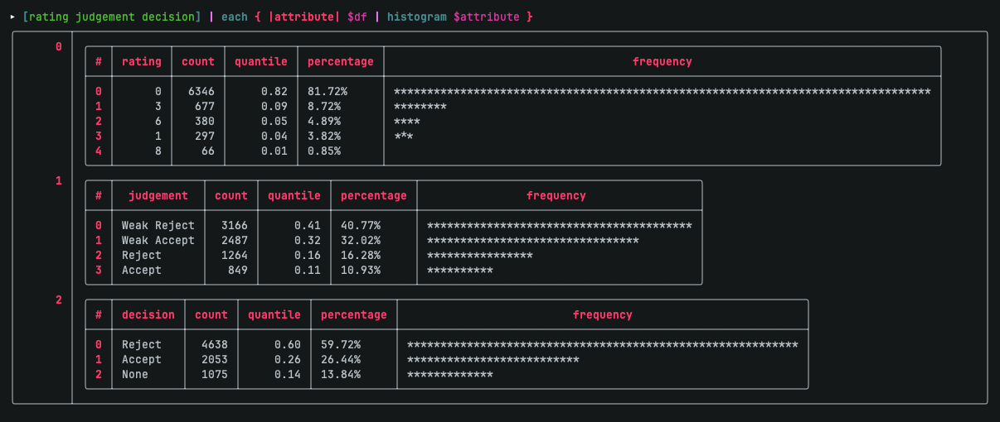

The total number of records is 7766. We can now count how many unique values we have for the most significant attributes, i.e. reviews, comments, and titles.

There are 7765 unique reviews, 2558 unique titles and 2201 unique comments; the command used to retrieve this information is the following:
```nushell
[review title comment]
	| each { |attr| {unique_($attr): ($df | select $attr | uniq | length)} }
	| into record
```

The uniqueness evaluation shows that reviews are the most unique attributes, hence they work better than titles if used as primary keys; comments, on the other hand, are often missing (1033 cases) or frequently repeated. Each article has between a minimum of 2 and a maximum of 5 related reviews.
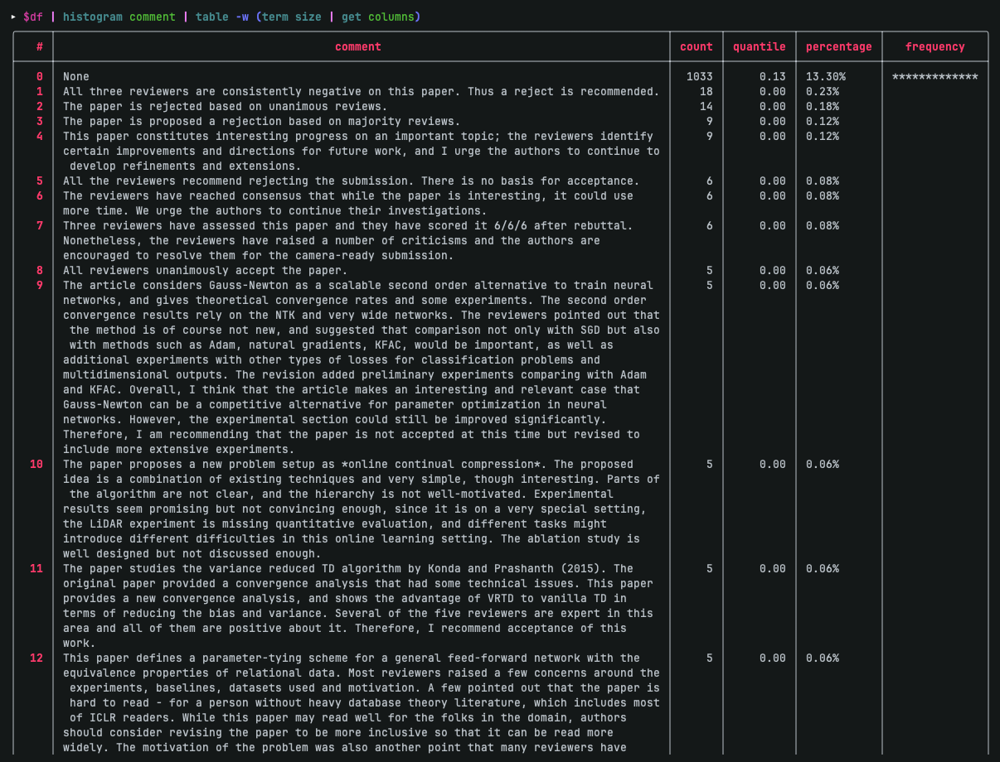
### 2.4. Attributes saliency evaluation
In order to obtain a solution to our problem, it is clearly confirmed by now that the most significant attributes in our datasets are reviews and comments. Let's briefly discuss how we can effectively harness them.

Reviews are the most information-rich attributes, and they outpaced in number comments; nevertheless, the latter are characterised by short, on point description, that in many cases explicitly spell out in one or two brief sentences the problems of the relative article. As such, we can work on two different frontiers: the first attempt will try to use just reviews; is the final result does not reach a sufficient level of satisfaction by our subjective criteria, we will attempt a second iteration using only comments. A conclusive, third round could use both comments and reviews at the same time; we leave this option as last resort, since it is the most computationally expensive.

## 3. Embedding generation

The general strategy is to extract meaningful, unique concepts from the reviews. We could do this work directly using an LLM, but doing this will poorly scale with the size of the dataset. We have to deal with less than 8000 reviews, but what if we like to make the problem manageable for 80'000, 800'000 or 80'000'000 reviews?

In order to be able to reasonably scale, we need some form of clustering which can enable us to select a small, representative set of all the reviews. Hence, the next logical step is to perform an embedding operation to create a numerical form for our data.

As such, at this point we can outline 3 main phases we need to go through:
1. Embedding phase: propedaeutic to the next phase, clustering
2. Clustering phase: needed to handle well scalability
3. Extraction phase: this is by far the most financially/computationally expensive part, since we will use an LLM to extract the most meaningful considerations present in the reviews of the datasets. Ideally, this phase should be made the less burdensome possible.

Let's start with the first phase: embedding. The question is now, what should we embed? Here we can identify two main solutions:

* (method 1): create one embedding for each review
* (method 2): create one embedding for each sentence

The first embedding method is clearly less expensive with respect to the second. Still, we should make some considerations:

* Embedding a whole review into a single, high-dimensional datapoint, can allow us to merely find similar reviews. As such, after we perform the clustering step, we go from 8'000 meaningful reviews to just 80, or even less. At that point, we can use an LLM to extract the most recurrent and important criticism/praises, but we have no guarantee that non-general sentences will be discarded (since they are review-specific and do not constitute a generic positive or negative opinion). In other words, we are really trading off quality for quantity and, in the case where reviews are very different one from the others, the clustering phase could lead to extremely poor results.
* Choosing to create an embedding for each sentence, especially using an LLM embedding, is more expensive, of course (but still orders of magnitude cheaper than passing prompts). Each review is composed of around 10-30 sentences, so we should expect the embedding cost to be multiplied by some number in this range with respect to (method 1). That said, using sentences instead of whole reviews should enable us to perform a more meaningful (and again, more expensive) clustering step. Intuitively, senteces containing generic considerations like "lacks clarity", "there is insufficient discussion", "detailed experimentation" should be more recurrent that review-specific details, so they should have an higher chance to pass on the clustering phase. This should also improve how much content we will pass to an LLM to extract generic considerations, basically reducing to the minimum the most expensive part of our analysis.
* Using sentence embeddings, we can front the clustering phase in batches, and repeat the process multiple times to approximate a global clustering; intuitively, the same should have limited reasonable effects for review embedding.


Given the considerations above, we will proceed using (method 2), sentence embedding.


First let's load the refined dataset into a pandas dataframe.

In [ ]:
import pandas as pd

df = pd.read_csv('/content/drive/MyDrive/kdpe/data/dataset.csv')
test_df = df.head(2)
print(df.head())

                                               title  \
0  Carpe Diem Seize The Samples Uncertain At The ...   
1  Analysis And Interpretation Of Deep Cnn Repres...   
2  Star Convexity In Non Negative Matrix Factoriz...   
3  Context Aware Attention Model For Coreference ...   
4  Stochastically Controlled Compositional Gradie...   

                                              review  rating    judgement  \
0   This paper proposes Recency Bias, an adaptive...       3  Weak Reject   
1  This paper proposes an analysis of convolution...       3  Weak Reject   
2  1. Typos: (1) “We will consider slighly weaker...       6  Weak Accept   
3  This paper proposes to use an extra feature (g...       1       Reject   
4   In the paper, the authors consider compositio...       3  Weak Reject   

  decision                                            comment  
0   Reject  The authors propose a new mini-batch selection...  
1   Reject  This paper aims to analyze CNN representations...  
2   Reje

Now, let's create a list of sentences from our reviews. We will use the `nltk` library.

In [ ]:
import nltk
nltk.download('punkt')
nltk.download('punkt_tab')

from nltk.tokenize import sent_tokenize

sentences = []
for review in df['review']:
    if isinstance(review, str):
      sentences.extend(sent_tokenize(review))
    else:
      print(f"Skipping non-string review: {review}")

sentences_df = pd.DataFrame(sentences, columns=['sentence'])
sentences_df.to_csv('/content/data/sentences.csv', index=False)

print(sentences)

[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package punkt_tab to /root/nltk_data...
[nltk_data]   Package punkt_tab is already up-to-date!


[' This paper proposes Recency Bias, an adaptive mini batch selection method for training deep neural networks.', 'To select informative minibatches for training, the proposed method maintains a fixed size sliding window of past model predictions for each data sample.', 'At a given iteration, samples which have highly inconsistent predictions within the sliding window are added to the minibatch.', 'The main contribution of this paper is the introduction of sliding window to remember past model predictions, as an improvement over the SOTA approach: Active Bias, which maintains a growing window of model predictions.', 'Empirical studies are performed to show the superiority of Recency Bias over two SOTA approaches.', 'Results are shown on the task of (1) image classification from scratch and (2) image classification by fine-tuning pretrained networks.', '+ves: + The idea of using a sliding window over a growing window in active batch selection is interesting.', '+ Overall, the paper is w

We obtain a list of 179'644 sentences. Given that there are 7'766 review, we have an average of around 23 sentences per review, which is in the range between 10 and 30, as expected. The next step is to create an embedding of each sentence. In order to make code snippets independent, let's load the previously saved sentences from the stored csv file into a Pandas dataframe.

In [ ]:
try:
  sentences_df = pd.read_csv('/content/data/sentences.csv')
  print(sentences_df.head())
except:
  print("File not found in the Colab runtime filesystem")

                                            sentence
0   This paper proposes Recency Bias, an adaptive...
1  To select informative minibatches for training...
2  At a given iteration, samples which have highl...
3  The main contribution of this paper is the int...
4  Empirical studies are performed to show the su...


Now, we can generate embeddings in multiple ways; we can either generate them using a cloud model, or using a local one. First, let's try to use a cloud model like Gemini.

In [ ]:
# Get the embeddings using Gemini

import google.generativeai as genai
from google.colab import userdata
from tqdm.auto import tqdm
import pandas as pd
import hashlib
import time

tqdm.pandas()
gemini_api_key = userdata.get('gemini-key')

def get_gemini_embedding(text):
    try:
        embedding_model = "gemini-embedding-exp-03-07"
        task_type_opt = "SEMANTIC_SIMILARITY"
        response = genai.embed_content(
            model = embedding_model,
            content = text,
            task_type = task_type_opt
        )
        return response['embedding']
    except:
        print(f"Embedding failed for text: {text}")
        return None

genai.configure(api_key=gemini_api_key)
sentences_df = pd.read_csv('/content/data/sentences.csv')
output_data= []
for index, row in tqdm(sentences_df.iterrows(), total=len(sentences_df), desc="Processing sentences"):
    sentence = row['sentence']
    embedding = get_gemini_embedding(sentence)
    sentence_bytes = sentence.encode('utf-8')
    sha256_hash = hashlib.sha256()
    sha256_hash.update(sentence_bytes)
    sentence_hash = sha256_hash.hexdigest()
    if embedding is not None:
        output_data.append([sentence_hash, sentence, embedding])
    time.sleep(1) # To avoid tornado access (error 429) from the Google AI API -- unfortunately not enough

output_df = pd.DataFrame(output_data, columns=['sha256','sentence', 'embedding'])
output_df.to_csv('/content/data/embeddings.csv', index=False)



The code above perfectly works, but is too slow because the cloud model has request throttling, limiting our ability to rapidly obtain embeddings for our 180'000 sentences. An alternative is to create embeddings using a local model, which should be a faster way to embed such a huge number of sentences (but probably not as accurate, since we are not using SOTA models anymore). Our model of choice is [MPNet V2](https://huggingface.co/sentence-transformers/all-mpnet-base-v2) trained by Microsoft over an extensive text corpus. This model is one of the best for semantic embedding when considering quality and speed; given the fact that we have to embed almost 180'000 sentences, this must be taken into consideration. Moreover, this model creates embeddings of 768 dimensions, which is quite a denser representation when compared to some of other models (where is not unsual to see embeddings of 2048, 4096 or 8192 dimensions). This aspect will be particularly advantageous during the clustering phase.

The code below can be executed in around 62 minutes in the free version of Google Colab.

In [ ]:
from sentence_transformers import SentenceTransformer
import pandas as pd
from tqdm.auto import tqdm
import hashlib
import warnings

warnings.filterwarnings("ignore", category=UserWarning, module='sentence_transformers')
model = SentenceTransformer('sentence-transformers/all-mpnet-base-v2')
sentences_df = pd.read_csv('/content/data/sentences.csv')
output_data= []
for index, row in tqdm(sentences_df.iterrows(), total=len(sentences_df), desc="Processing sentences"):
    sentence = row['sentence']
    embedding = model.encode(sentence)
    sentence_bytes = sentence.encode('utf-8')
    sha256_hash = hashlib.sha256()
    sha256_hash.update(sentence_bytes)
    sentence_hash = sha256_hash.hexdigest()
    if embedding is not None:
        output_data.append([sentence_hash, sentence, embedding])

output_df = pd.DataFrame(output_data, columns=['sha256','sentence', 'embedding'])
output_df.to_csv('/content/data/embeddings.csv', index=False)

modules.json:   0%|          | 0.00/349 [00:00<?, ?B/s]

config_sentence_transformers.json:   0%|          | 0.00/116 [00:00<?, ?B/s]

README.md:   0%|          | 0.00/10.4k [00:00<?, ?B/s]

sentence_bert_config.json:   0%|          | 0.00/53.0 [00:00<?, ?B/s]

config.json:   0%|          | 0.00/571 [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/438M [00:00<?, ?B/s]

tokenizer_config.json:   0%|          | 0.00/363 [00:00<?, ?B/s]

vocab.txt:   0%|          | 0.00/232k [00:00<?, ?B/s]

tokenizer.json:   0%|          | 0.00/466k [00:00<?, ?B/s]

special_tokens_map.json:   0%|          | 0.00/239 [00:00<?, ?B/s]

config.json:   0%|          | 0.00/190 [00:00<?, ?B/s]

Processing sentences:   0%|          | 0/179644 [00:00<?, ?it/s]

## 4. Embeddings clustering
We now have to provide a strong clustering. This phase is crucial to ensure a qualitative final result, but we have also to take into account about computational complexity requirements.

In [ ]:
import pandas as pd

embeddings_df = pd.read_csv('/content/drive/MyDrive/kdpe/data/embeddings.csv')

In [ ]:
embeddings_v = embeddings_df['embedding'].str.replace(r'[\r\n]+', '', regex=True).tolist()

In [ ]:
del embeddings_df # Force garbage collection to remain in the 13GiB RAM limits
float_embeddings = [list(map(float, embedding_v.strip("[]").split())) for embedding_v in embeddings_v]

In [ ]:
embeddings_npo = pd.DataFrame(float_embeddings).values # Convert to a NumPy array
del float_embeddings # Force garbage collection to remain in the 13GiB RAM limits
print(embeddings_npo)

[[-6.48448840e-02  5.71856014e-02 -3.08328122e-02 ... -2.85472615e-05
   3.05924192e-03 -4.78771329e-02]
 [-5.30175082e-02  5.65791093e-02 -1.35849062e-02 ... -1.14861513e-02
  -1.89105477e-02 -3.29198502e-02]
 [-2.94327978e-02 -4.24667746e-02 -5.08073578e-03 ... -2.43954416e-02
  -2.62614824e-02 -4.94967252e-02]
 ...
 [ 1.85070708e-02  5.30030131e-02 -2.14876961e-02 ...  1.70263890e-02
  -8.57867673e-03 -4.61556278e-02]
 [-3.50191705e-02  1.15873329e-02 -3.79329249e-02 ... -1.63773205e-02
  -1.84877701e-02 -1.37664797e-02]
 [-5.86850010e-03  3.91185395e-02 -1.84873324e-02 ... -5.75897330e-03
  -2.26337221e-02 -5.09350002e-02]]


Let's first try a fast and easy clustering attempt using minibatch k-means. This algorithm requires some more work to later find actual representative embeddings, but it is fast, and requires little memory.

In [ ]:
from sklearn.cluster import MiniBatchKMeans

k = 1000
kmeans = MiniBatchKMeans(n_clusters=k, random_state=42, batch_size=1000, verbose=1)
clusters = kmeans.fit_predict(embeddings_npo)
print(clusters)

Init 1/1 with method k-means++
Inertia for init 1/1: 2490.559264278859
[MiniBatchKMeans] Reassigning 500 cluster centers.
Minibatch step 1/17964: mean batch inertia: 0.8414522088932108
[MiniBatchKMeans] Reassigning 500 cluster centers.
Minibatch step 2/17964: mean batch inertia: 0.7178438207303577, ewa inertia: 0.7178438207303577
[MiniBatchKMeans] Reassigning 467 cluster centers.
Minibatch step 3/17964: mean batch inertia: 0.6525364984519849, ewa inertia: 0.7171167498708473
Minibatch step 4/17964: mean batch inertia: 0.6332691422271277, ewa inertia: 0.7161832687537139
Minibatch step 5/17964: mean batch inertia: 0.623969235169136, ewa inertia: 0.7151566436477039
Minibatch step 6/17964: mean batch inertia: 0.6003812543812529, ewa inertia: 0.7138788414348235
Minibatch step 7/17964: mean batch inertia: 0.5946578386834779, ewa inertia: 0.7125515459047354
Minibatch step 8/17964: mean batch inertia: 0.5981682557841542, ewa inertia: 0.7112781089583068
Minibatch step 9/17964: mean batch inertia

In [ ]:
import numpy as np

np.save('clusters.npy', clusters)

Some tests run outside of this Colab notebook, show that k-means is very sensitive the the number of clusters required. In general, a high number of clusters tends to get representative sentences which are not always interesting. A limited number of final clusters tends to select more meaningful content, but many interesting findings extracted in the LLM-only approach seen in class are not included.

In this notebook we will try a different approach, using a k-medoid selection methodology. In particular, we will use CLARANS as our driving algorithm. CLARANS (Clustering Large Applications with Randomized Search), which is an extension of the k-medoids algorithm, is specifically designed to scale better for large datasets, where the full k-medoids would be too slow. It brings several advantages over the k-means algorithms variations (standard and minibatch, for example):

1. Gives us interpretable cluster centers (i.e. the medoids are actual representative embeddings, not synthetic centroids)
2. k-means assumes spherical, similarly sized and equivalently dense clusters; the same is not true for CLARANS, that uses the PAM strategy (partitioning around medoids)
3. CLARANS better behaves with many arbitrary distance metrics like Cosine, Manhattan, Jaccard and Euclidean, while k-means works better with the latter only.

There are other alternatives to CLARANS, like DBSCAN and its variations, which in principle have other advantages (like more robustness to noise and outliers), but they scale worse and need some serious dimensionality reduction to be run in a resource-constrained enviromenment like that of Colab.

Even with CLARANS, in order to make it more performant, we need to perform some initial tuning to reach convergence in a reasonable amount of time. Let's start with some PCA to reduce from 768 to 128 dimensions the size of the embeddings.


In [10]:
!pip install pyclustering

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.1/2.1 MB 26.2 MB/s eta 0:00:00


In [8]:
from sklearn.decomposition import PCA
import numpy as np

pca = PCA(n_components=128, random_state=42)
embeddings_pca = pca.fit_transform(embeddings_npo)
print(embeddings_pca)

[[ 0.41371331 -0.17754495 -0.09339119 ... -0.02021633  0.00258295
   0.00647593]
 [ 0.36552214 -0.05984781 -0.18198806 ... -0.02205257 -0.00795758
   0.01582025]
 [ 0.12252858  0.09437502  0.01007441 ...  0.00230587  0.01011465
   0.02823003]
 ...
 [-0.27638853  0.38473829 -0.06858778 ... -0.0187156   0.03965927
   0.04284907]
 [ 0.28047439  0.03426549  0.17442277 ...  0.02203468  0.03980875
   0.01985281]
 [ 0.29822463 -0.06380863 -0.01141971 ...  0.00770588 -0.02014114
  -0.0639105 ]]


And now let's cluster with CLARANS. The idea is to get at least 100 clusters, with at most 50 direct neighbours. Note that this clustering strategy is pretty aggressive, but necessary to scale well on even bigger datasets.

If anything, we can prove to what extent leveraing an extensive intermediate clustering can work well to alleviate the burden of the third phase (LLM-aided considerations extraction).



In [ ]:
from pyclustering.cluster.clarans import clarans
from pyclustering.utils.metric import type_metric, distance_metric

# data = embeddings_pca.to_list()

num_clusters = 100
num_local = 5
max_neighbor = 50
clarans_instance = clarans(
    embeddings_pca,
    num_clusters,
    num_local,
    max_neighbor
)
clarans_instance.process()
clarans_clusters = clarans_instance.get_clusters()


The algorithm above requires around 11 hours of runtime using Colab. It is not GPU-accelerated, though. With the following step we will get the medoid indexes:

In [ ]:
medoid_indexes = clarans_instance.get_medoids()

Now we can retrieve the representative sentences:

In [ ]:
embeddings_df = pd.read_csv('/content/drive/MyDrive/kdpe/data/embeddings.csv')
sentences = embeddings_df['sentence'].tolist()
repr_sentences = [sentences[i] for i in medoid_indexes]

## 5. Saliency-driven extraction
In this last phase, we use as input the sentences selected in the previous stage as the starting point for the LLM-aided extraction process. We will use OpenRouter API to automate the prompting to SOTA cloud models, employing a progressive abstraction of the representative sentences, in order to remove review-specific ones.

First, let's test the available openrouter API key.

In [ ]:
import requests
from google.colab import userdata

openrouter_api_key = userdata.get('openrouter-key')

headers = {
    "Authorization": f"Bearer {openrouter_api_key}",
    "Content-Type": "application/json",
}

data = {
    "model": "openai/gpt-4", # As an alternative: google/gemini-pro
    "messages": [
        {"role": "user", "content": "Can you tell me a joke?"}
    ]
}

response = requests.post("https://openrouter.ai/api/v1/chat/completions", headers=headers, json=data)
print(response.json())


Now let's provide the list of meaningful, representative sentences, and instruct the LLM to extract a list of positive and negative considerations present in those sentences, relative to possible acceptance or rejection of the relative papers.


In [ ]:
instructions = """
You are an expert in analyzing academic paper reviews. You will receive a list
of sentences taken from some academic paper reviews. I want you to extract both
possible reason of acceptance and rejection. Remember that every extraction must
be faithful to the following principles:
- only generic considerations are valid (examples: "lacking clarity", "limited
discussion of results" or similar reasons); for each correctly derived generic
reason leading to acceptance or rejection, I will award you of 1 point.
- you will be penalized by 1 point every time you will include detailed reasons
for acceptance or rejection
- no technology or methods specific name should be included, only generic identifiers

Structure your output results, dividing them in "Potential reasons of acceptance"
and "Potential reasons of rejection". Each of these two section should contain at
least 5 reasons, put in an ordered list, in the form "<title>: <description>", where the <title> is a short
title for the reason, while the <description> is a short but informative description
of the reason itself.
"""

prompt = (instructions + '\n'.join(
    [f"{i+1}. {s}" for i, s in enumerate(repr_sentences)]
))

data = {
    "model": "openai/gpt-4", # As an alternative: google/gemini-pro
    "messages": [
        {"role": "user", "content": prompt}
    ]
}

response = requests.post("https://openrouter.ai/api/v1/chat/completions", headers=headers, json=data)
print(response.json())

The following is a sample output taken from one out of 5 LLM calls. The (subjectively) best one is selected:

✅ Potential Acceptance Reasons

1. Strong Empirical or Theoretical Support:
Demonstrates effectiveness through solid experiments or rigorous analysis.

2. Clear Motivation and Relevance:
Addresses a significant problem with practical or theoretical importance.

3. Thorough Evaluation and Comparison:
Includes ablations, comparisons to baselines, and well-designed experiments.

4. Clarity and Quality of Presentation:
Communicates ideas clearly, making the work accessible and reproducible.

5. Sound and Justified Methodology:
Uses well-grounded assumptions and transparent reasoning.

6. Novel and Valuable Contribution:
Introduces original ideas, methods, or resources that meaningfully advance the field.


❌ Potential Rejection Reasons
1. Lack of Novelty or Impact:
Offers only minor or obvious improvements without clear advancement.

2. Missing or Flawed Comparisons:
Fails to compare with strong baselines or ignores related work.

3. Weak or Incomplete Evaluation:
Results are marginal, not well demonstrated, or tested on limited benchmarks.

4. Poor Presentation or Clarity:
Writing, structure, or notation is unclear, preventing proper evaluation.

5. Limited Scope or Relevance:
Applies only to narrow cases or lacks real-world applicability.

6. Methodological Issues:
Relies on unjustified heuristics, flawed assumptions, or technical errors.

The results above are not taken using the OpenRouter API key, because for some reason requests are rejected. Still, we can use the given instruction prompt and manually put the whole instructions + representative sentences as input.

**LLM reasoning refinement**

In order to help the model think more deeply about the reason of rejection or acceptance, we also ask it the follow the subsequent addendum:



> List the most frequent reasons of acceptance and rejection of scientific papers, and compare them to the reason you extracted from the previous prompt. Do not add reasons that are not present in your previous response message: you are only allowed to compare them with the general, frequent acceptance/rejection reasons, and refine the phrasing.



This helps structure the output as we see above, basically only improving the "generality" requirement. In other words, this technique seems to work as an abstraction strategy, since the model can compare the general, vague reasons and match them to those found within the representative sentences context.

## 6. Conclusive discussion

The final results are good, but not optimal. Many acceptance/rejection reasons are left out, but we think this is mainly due to the aggressive clustering. The LLM reasoning refinement seems to help to further eliminate details, and is really simple to implement (basically just an additional prompting!). In addition, LLMs tend to report a symmetry number of acceptance and rejection reasons, and this seems to apply to both Gemini and ChatGPT; the motivations are obscure.

**Computational resources considerations**

The applied methodology has strongly privileged the clustering phase to a deluge of LLM calls. The LLM only approach seen in class still seems to be give more detailed responses, but of course it is way more expensive.

Using the strategy present in this notebook, we can essentially do few LLM calls (like 10 or less) in order to iteratively try to push the model to get the best out of our representative sentences. Sometimes there are still irrelevant details, but because the material to work on at this point is so few, we can manually adjust what is still not convincing enough.

Doing a token expense calculation is virtually useless, here, since this is probably the second less LLM reliant methodology one can devised, the least one being not using an LLM at all.

**Possible improvements**

The only realistically useful results seem to come when using a memoid-aware algorithm like CLARANS. We would loved to use a well tuned k-means to reach the same objective, since it is much faster and scales humongously better. Moreover, there are GPU implementations that make even shorter the practical runtime execution, while this seems to not be the case for CLARANS (outside from exotic, not battle-tested implementations).